### Use Machine Learning to Classify Geographic Terrorism Risk Clusters 

#### Overview
##### Research question:
Can we identify high-risk geographic clusters of terrorism attacks using the Global Terrorism Database on Kaggle, to support pre-travel guidance and decision-making?

##### Data Source and Attribution
The analysis will use the Global Terrorism Database (GTD), available on Kaggle: https://www.kaggle.com/datasets/START-UMD/gtd. This dataset contains detailed records of over 180,000 terrorist incidents worldwide from 1970 to 2017, including date, location, weapons used, target type, and casualties.
> **Citation**:  
> National Consortium for the Study of Terrorism and Responses to Terrorism (START), University of Maryland. (2018).  *The Global Terrorism Database (GTD) [Data file].*  Retrieved from [https://www.start.umd.edu/gtd](https://www.start.umd.edu/gtd)

> **Copyright Notice**:  
> Copyright University of Maryland 2018.

> **Data Modifications**:  
> This analysis includes preprocessing of the original GTD dataset, including:
> - Filtering for relevant columns (e.g., country, region, latitude, longitude, casualties),
> - Handling missing values,
> - Creating a "casualties" column to represent attack severity.
>  
> These transformations were made solely for clustering and visualization purposes. They do not reflect any analytical decisions or interpretations made by the National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland.

##### Techniques to use:
* Data Preprocessing: Handle missing values, and filter relevant periods and columns (e.g., country, region, latitude, longitude, number of casualties, and attack type).
* Exploratory Data Analysis: Visualize attack frequency by region, time trends, and severity.
* Clustering Models: Since my main task is to cluster geographic regions into risk zones, I will use unsupervised learning models like K-Means or DBSCAN on spatial and severity features (e.g., latitude, longitude, casualties) to group areas into high, medium, and low-risk zones.
* Visualization: Use Plotly to provide visual risk maps.

##### Expected results:
* Creation of distinct geographic clusters that classify regions into high, medium, and low-risk zones based on historical terrorist activity.
* Plots showing attack density and severity across continents and countries.

##### Why this question is important?
The question is important because it can help travelers and organizations assess security risks for travel destinations, enhance public awareness and preparedness for travel in sensitive regions, and transform raw terrorism data into actionable intelligence for both individuals and institutions. 



#### Install package to get the GPS location for a given city

In [4]:
!pip install geopy

Defaulting to user installation because normal site-packages is not writeable


#### Import and Setup

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from geopy.geocoders import Nominatim
import time
import warnings
warnings.filterwarnings('ignore')

#### Data overview

##### Column name and description based on the official GTD codebook provided by START (University of Maryland). 
| Column Name                  | Description                                           |
| ---------------------------- | ----------------------------------------------------- |
| `eventid`                    | Unique ID for the event (formatted YYYYMMDDXX)        |
| `iyear`                      | Year of the incident                                  |
| `imonth`                     | Month of the incident (0 = unknown)                   |
| `iday`                       | Day of the incident (0 = unknown)                     |
| `approxdate`                 | Approximate date when the actual day is unknown       |
| `extended`                   | Whether the incident extended beyond 24 hours         |
| `resolution`                 | How the extended incident was resolved                |
| `country`                    | Numeric code for the country                          |
| `country_txt`                | Country name                                          |
| `region`                     | Numeric code for the region                           |
| `region_txt`                 | Region name                                           |
| `provstate`                  | Province, state, or administrative division           |
| `city`                       | City where the attack occurred                        |
| `latitude`                   | Latitude of the incident location                     |
| `longitude`                  | Longitude of the incident location                    |
| `specificity`                | Geographic specificity of the location                |
| `vicinity`                   | Whether the attack happened in or near the city       |
| `location`                   | Additional descriptive location info                  |
| `summary`                    | Narrative summary of the event                        |
| `crit1`                      | Criterion 1 of GTD terrorist definition met (1 = yes) |
| `crit2`                      | Criterion 2 met                                       |
| `crit3`                      | Criterion 3 met                                       |
| `doubtterr`                  | Doubt that the incident was an act of terrorism       |
| `alternative`                | Alternative explanation code                          |
| `alternative_txt`            | Text label of alternative eguncertainxplanation                 |
| `multiple`                   | Was part of multiple coordinated attacks              |
| `success`                    | Whether the attack achieved its goal                  |
| `suicide`                    | Whether it was a suicide attack                       |
| `attacktype1`                | Code for primary attack type                          |
| `attacktype1_txt`            | Description of primary attack type                    |
| `attacktype2`                | Secondary attack type code                            |
| `attacktype2_txt`            | Description of secondary attack type                  |
| `attacktype3`                | Tertiary attack type code                             |
| `attacktype3_txt`            | Description of tertiary attack type                   |
| `targtype1`                  | Code for type of first target                         |
| `targtype1_txt`              | Text label for type of first target                   |
| `targsubtype1`               | Subtype code of first target                          |
| `targsubtype1_txt`           | Subtype text of first target                          |
| `corp1`                      | Organization/company name of first target             |
| `target1`                    | Specific entity or person targeted                    |
| `natlty1`                    | Nationality code of first target                      |
| `natlty1_txt`                | Nationality of first target                           |
| `targtype2`                  | Code for type of second target                        |
| `targtype2_txt`              | Text label for type of second target                  |
| `targsubtype2`               | Subtype code of second target                         |
| `targsubtype2_txt`           | Subtype text of second target                         |
| `corp2`                      | Organization/company of second target                 |
| `target2`                    | Specific entity or person targeted (2nd target)       |
| `natlty2`                    | Nationality code of second target                     |
| `natlty2_txt`                | Nationality of second target                          |
| `targtype3`                  | Code for type of third target                         |
| `targtype3_txt`              | Text label for type of third target                   |
| `targsubtype3`               | Subtype code of third target                          |
| `targsubtype3_txt`           | Subtype text of third target                          |
| `corp3`                      | Organization/company of third target                  |
| `target3`                    | Specific entity or person targeted (3rd target)       |
| `natlty3`                    | Nationality code of third target                      |
| `natlty3_txt`                | Nationality of third target                           |
| `gname`                      | Name of the perpetrator group                         |
| `gsubname`                   | Subgroup name (if any)                                |
| `gname2`                     | Second perpetrator group                              |
| `gsubname2`                  | Subgroup of second group                              |
| `gname3`                     | Third perpetrator group                               |
| `gsubname3`                  | Subgroup of third group                               |
| `motive`                     | Suspected or known motive (free-text)                 |
| `guncertain1`                | Uncertainty about responsibility of first group       |
| `guncertain2`                | Uncertainty for second group                          |
| `guncertain3`                | Uncertainty for third group                           |
| `individual`                 | Was the attack carried out by individuals?            |
| `nperps`                     | Number of perpetrators                                |
| `nperpcap`                   | Number of perpetrators captured                       |
| `claimed`                    | First group claimed responsibility?                   |
| `claimmode`                  | Mode of claim (e.g., letter, video)                   |
| `claimmode_txt`              | Description of claim mode                             |
| `claim2`                     | Second group claim                                    |
| `claimmode2`                 | Claim mode of second group                            |
| `claimmode2_txt`             | Text for second claim mode                            |
| `claim3`                     | Third group claim                                     |
| `claimmode3`                 | Claim mode of third group                             |
| `claimmode3_txt`             | Text for third claim mode                             |
| `compclaim`                  | Were there competing claims?                          |
| `weaptype1`                  | Primary weapon type code                              |
| `weaptype1_txt`              | Primary weapon description                            |
| `weapsubtype1`               | Weapon subtype code                                   |
| `weapsubtype1_txt`           | Subtype description                                   |
| `weaptype2`                  | Secondary weapon type                                 |
| `weaptype2_txt`              | Text label for secondary weapon                       |
| `weapsubtype2`               | Secondary weapon subtype                              |
| `weapsubtype2_txt`           | Subtype text                                          |
| `weaptype3`                  | Third weapon type                                     |
| `weaptype3_txt`              | Text label for third weapon                           |
| `weapsubtype3`               | Third weapon subtype                                  |
| `weapsubtype3_txt`           | Text label                                            |
| `weaptype4`                  | Fourth weapon type                                    |
| `weaptype4_txt`              | Text label                                            |
| `weapsubtype4`               | Fourth weapon subtype                                 |
| `weapsubtype4_txt`           | Subtype description                                   |
| `weapdetail`                 | Free-text detail on weapons used                      |
| `nkill`                      | Number of people killed                               |
| `nkillus`                    | Number of U.S. nationals killed                       |
| `nkillter`                   | Number of perpetrators killed                         |
| `nwound`                     | Number of people wounded                              |
| `nwoundus`                   | Number of U.S. nationals wounded                      |
| `nwoundte`                   | Number of perpetrators wounded                        |
| `property`                   | Was property damaged?                                 |
| `propextent`                 | Extent of property damage (coded)                     |
| `propextent_txt`             | Text for property damage extent                       |
| `propvalue`                  | Estimated property damage value                       |
| `propcomment`                | Notes on property damage                              |
| `ishostkid`                  | Were hostages or kidnapped victims involved?          |
| `nhostkid`                   | Number of hostages/kidnappings                        |
| `nhostkidus`                 | Number of U.S. hostages                               |
| `nhours`                     | Duration of hostage situation in hours                |
| `ndays`                      | Duration in days                                      |
| `divert`                     | Flight diversion location (if hijacking)              |
| `kidhijcountry`              | Country involved in hijacking                         |
| `ransom`                     | Was ransom demanded?                                  |
| `ransomamt`                  | Total ransom amount demanded                          |
| `ransomamtus`                | Amount demanded in USD                                |
| `ransompaid`                 | Amount paid in local currency                         |
| `ransompaidus`               | Amount paid in USD                                    |
| `ransomnote`                 | Was a ransom note involved?                           |
| `hostkidoutcome`             | Code for hostage situation outcome                    |
| `hostkidoutcome_txt`         | Outcome description                                   |
| `nreleased`                  | Number of hostages released                           |
| `addnotes`                   | Additional notes by researchers                       |
| `scite1`, `scite2`, `scite3` | Sources used for coding                               |
| `dbsource`                   | Source database(s) used                               |
| `INT_LOG`                    | Linkage to international logistics                    |
| `INT_IDEO`                   | Linkage to international ideology                     |
| `INT_MISC`                   | Other international link                              |
| `INT_ANY`                    | Any international involvement                         |
| `related`                    | Event IDs of related attacks                          |

In [11]:
df_full = pd.read_csv('data/globalterrorismdb_0718dist.csv', encoding='ISO-8859-1')
df_full.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


#### Exploratory Data Analysis

In [14]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [16]:
df_full.isna().sum()

eventid            0
iyear              0
imonth             0
iday               0
approxdate    172452
               ...  
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
related       156653
Length: 135, dtype: int64

##### Data visualization

The number of terrorist attacks appears to have increased significantly between 2008 and 2017.

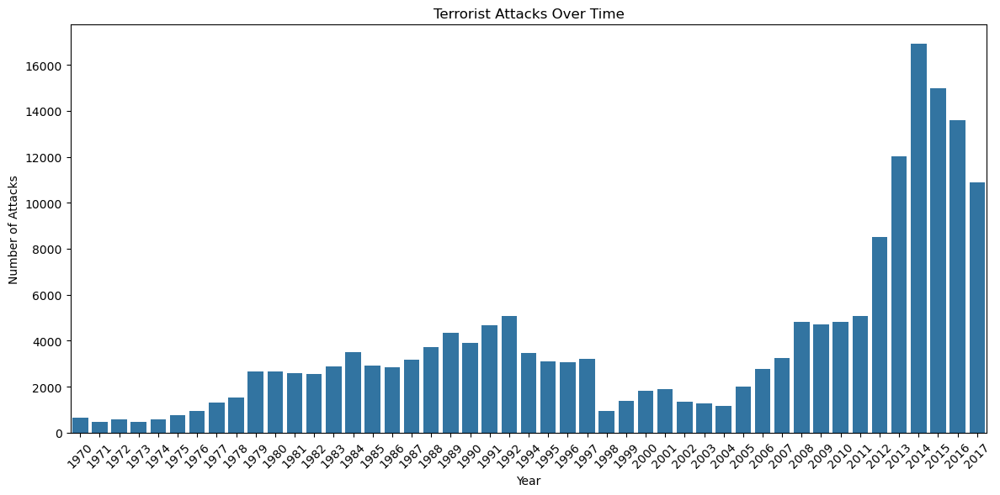

In [20]:
plt.figure(figsize=(12,6))
sns.countplot(data=df_full, x='iyear')
plt.title('Terrorist Attacks Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The Middle East and North Africa region reports the highest number of terrorist attacks, followed by South Asia.

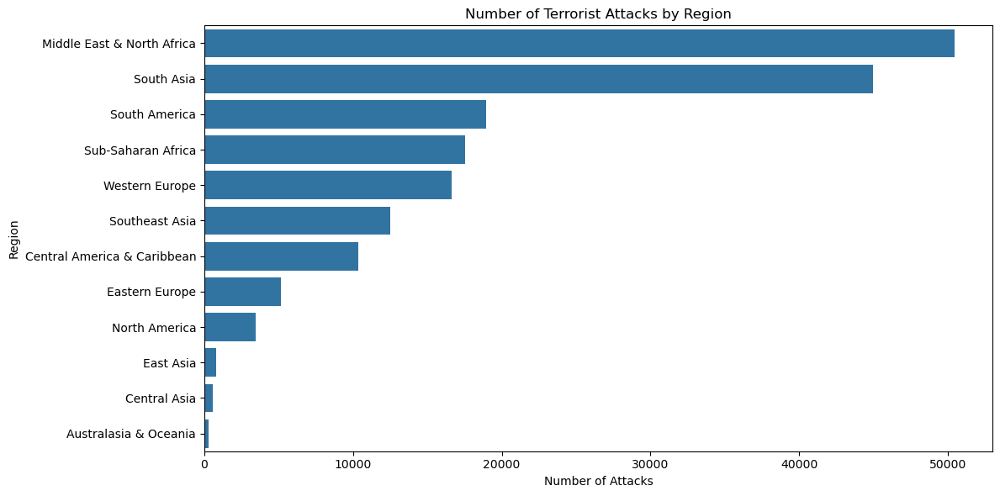

In [23]:
plt.figure(figsize=(12,6))
sns.countplot(data=df_full, y='region_txt', order=df_full['region_txt'].value_counts().index)
plt.title('Number of Terrorist Attacks by Region')
plt.xlabel('Number of Attacks')
plt.ylabel('Region')
plt.tight_layout()
plt.show()

Iraq recorded the highest number of terrorist attacks.

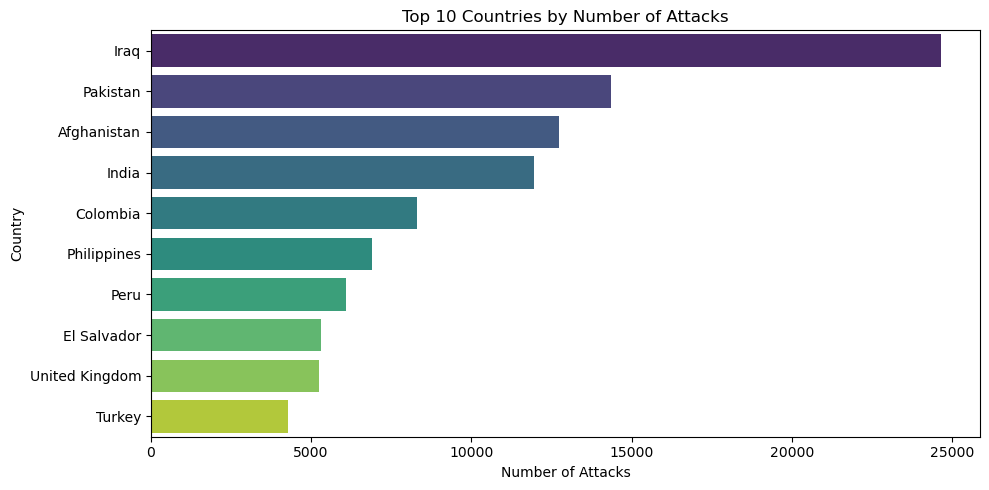

In [26]:
top_countries = df_full['country_txt'].value_counts().head(10)
plt.figure(figsize=(10,5))
sns.barplot(y=top_countries.index, x=top_countries.values, palette='viridis')
plt.title('Top 10 Countries by Number of Attacks')
plt.xlabel('Number of Attacks')
plt.ylabel('Country')
plt.tight_layout()
plt.show()

The most frequently used attack type is bombing/explosion.

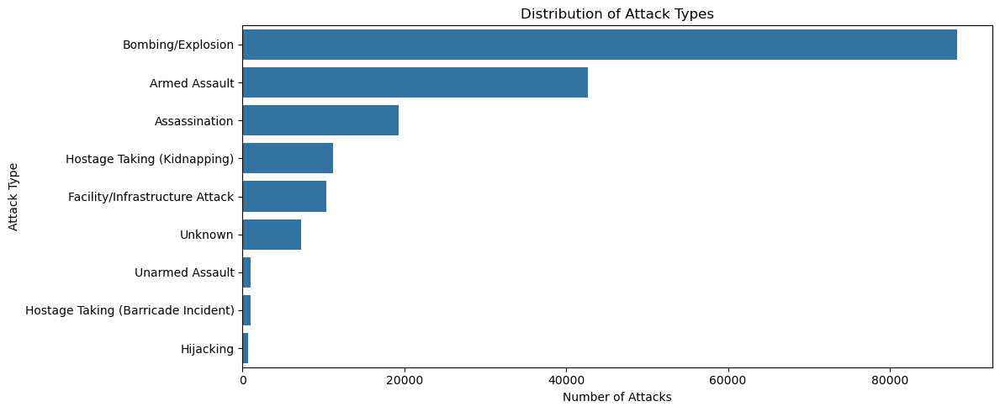

In [29]:
plt.figure(figsize=(12,5))
sns.countplot(y='attacktype1_txt', data=df_full, order=df_full['attacktype1_txt'].value_counts().index)
plt.title('Distribution of Attack Types')
plt.xlabel('Number of Attacks')
plt.ylabel('Attack Type')
plt.tight_layout()
plt.show()

Here is the distribution of kills and wounds per attack

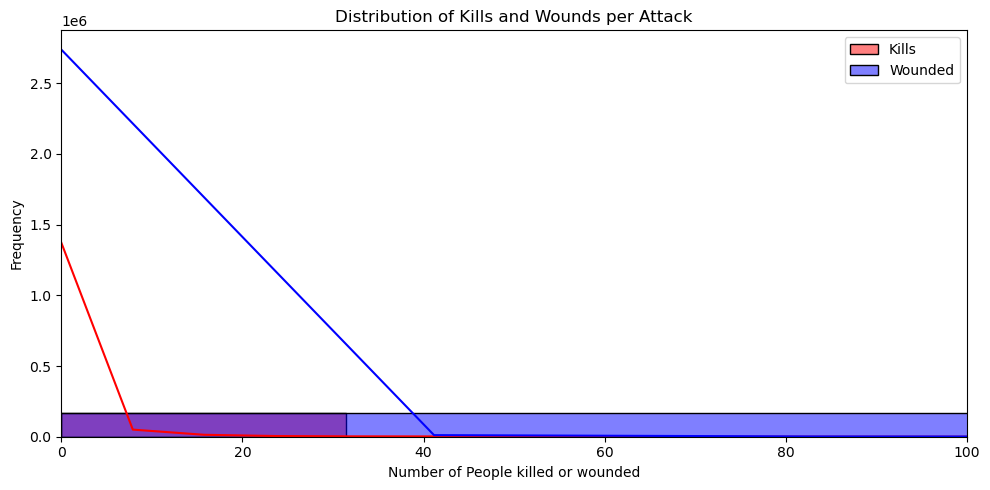

In [32]:
plt.figure(figsize=(10,5))
sns.histplot(df_full['nkill'], bins=50, kde=True, color='red', label='Kills')
sns.histplot(df_full['nwound'], bins=50, kde=True, color='blue', label='Wounded')
plt.title('Distribution of Kills and Wounds per Attack')
plt.xlabel('Number of People killed or wounded')
plt.ylabel('Frequency')
plt.xlim(0, 100)
plt.legend()
plt.tight_layout()
plt.show()

##### Data Setup

 Exclude all columns like summaries, notes, and motives

In [36]:
narrative_cols = [col for col in df_full.columns if any(key in col.lower() for key in ['summary', 'motive', 'addnote', 'scite', 'notes'])]
df = df_full.drop(columns = narrative_cols)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 129 entries, eventid to related
dtypes: float64(55), int64(22), object(52)
memory usage: 178.8+ MB


Exclude all columns fields are useful for in-depth forensic or behavioral analysis but not directly relevant to geographic risk clustering.

In [39]:
keywords = ['claim', 'corp', 'group', 'gname', 'gsubname', 'guncertain',
 'hostkid', 'individual', 'int_', 'natlty', 'nperp', 'property', 'propextent',
 'ransom', 'targ', 'target', 'weap', 'weapon']
matching_columns = [col for col in df.columns if any(kw.lower() in col.lower() for kw in keywords)]
df = df.drop(columns = matching_columns)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 48 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   eventid          181691 non-null  int64  
 1   iyear            181691 non-null  int64  
 2   imonth           181691 non-null  int64  
 3   iday             181691 non-null  int64  
 4   approxdate       9239 non-null    object 
 5   extended         181691 non-null  int64  
 6   resolution       2220 non-null    object 
 7   country          181691 non-null  int64  
 8   country_txt      181691 non-null  object 
 9   region           181691 non-null  int64  
 10  region_txt       181691 non-null  object 
 11  provstate        181270 non-null  object 
 12  city             181256 non-null  object 
 13  latitude         177135 non-null  float64
 14  longitude        177134 non-null  float64
 15  specificity      181685 non-null  float64
 16  vicinity         181691 non-null  int6

Exclude other fields manually

In [42]:
other_columns = ['eventid','alternative','alternative_txt','multiple','nhours','ndays','divert','kidhijcountry','nreleased','dbsource','related']
df = df.drop(columns = other_columns)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 37 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   iyear            181691 non-null  int64  
 1   imonth           181691 non-null  int64  
 2   iday             181691 non-null  int64  
 3   approxdate       9239 non-null    object 
 4   extended         181691 non-null  int64  
 5   resolution       2220 non-null    object 
 6   country          181691 non-null  int64  
 7   country_txt      181691 non-null  object 
 8   region           181691 non-null  int64  
 9   region_txt       181691 non-null  object 
 10  provstate        181270 non-null  object 
 11  city             181256 non-null  object 
 12  latitude         177135 non-null  float64
 13  longitude        177134 non-null  float64
 14  specificity      181685 non-null  float64
 15  vicinity         181691 non-null  int64  
 16  location         55495 non-null   obje

In [44]:
cols = ['iyear', 'country_txt', 'region_txt', 'city','latitude', 'longitude', 'nkill', 'nwound', 'attacktype1_txt']
df = df[cols]
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Data columns (total 9 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   iyear            181691 non-null  int64  
 1   country_txt      181691 non-null  object 
 2   region_txt       181691 non-null  object 
 3   city             181256 non-null  object 
 4   latitude         177135 non-null  float64
 5   longitude        177134 non-null  float64
 6   nkill            171378 non-null  float64
 7   nwound           165380 non-null  float64
 8   attacktype1_txt  181691 non-null  object 
dtypes: float64(4), int64(1), object(4)
memory usage: 12.5+ MB


Due to the large dataset size and limited local computing resources, I reduced the sample by selecting data from only the most recent ten years.

In [47]:
latest_year = df['iyear'].max()
df_last10year = df[df['iyear'] >= latest_year - 9]
df_last10year.info()

<class 'pandas.core.frame.DataFrame'>
Index: 96341 entries, 85348 to 181690
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   iyear            96341 non-null  int64  
 1   country_txt      96341 non-null  object 
 2   region_txt       96341 non-null  object 
 3   city             95987 non-null  object 
 4   latitude         95762 non-null  float64
 5   longitude        95762 non-null  float64
 6   nkill            92446 non-null  float64
 7   nwound           89542 non-null  float64
 8   attacktype1_txt  96341 non-null  object 
dtypes: float64(4), int64(1), object(4)
memory usage: 7.4+ MB


Select input features along with geographic coordinates to cluster attacks into risk-level groups.

In [50]:
df_last10year = df_last10year.dropna(subset=['latitude', 'longitude','nkill','nwound'])
df_last10year.info()

<class 'pandas.core.frame.DataFrame'>
Index: 88780 entries, 85348 to 181690
Data columns (total 9 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   iyear            88780 non-null  int64  
 1   country_txt      88780 non-null  object 
 2   region_txt       88780 non-null  object 
 3   city             88433 non-null  object 
 4   latitude         88780 non-null  float64
 5   longitude        88780 non-null  float64
 6   nkill            88780 non-null  float64
 7   nwound           88780 non-null  float64
 8   attacktype1_txt  88780 non-null  object 
dtypes: float64(4), int64(1), object(4)
memory usage: 6.8+ MB


#### Base model
First step: find the modes for both nkill and nwound.

In [53]:
mode_value_nkill = df_last10year['nkill'].mode().iloc[0]
print(mode_value_nkill)
mode_value_nwound = df_last10year['nwound'].mode().iloc[0]
print(mode_value_nwound)

0.0
0.0


Second step: get the percentage of rows in a DataFrame where both nkill and nwound are equal to their respective modes and use it as the base mode.

In [56]:
condition = (df_last10year['nkill'] == mode_value_nkill) & (df_last10year['nwound'] == mode_value_nwound)
percentage = (condition.sum() / len(df_last10year)) * 100
print(f"Percentage of rows with mode values: {percentage:.2f}%")

Percentage of rows with mode values: 32.71%


Therefore, the baseline accuracy would be **32.71%** if we always assumed each attack resulted in no wounds.

#### Model Training

Because fatalities (nkill) are generally considered more severe than non-fatal injuries (nwound), I weighted nkill more heavily in the clustering process. Organizations such as the WHO, UN, and various security analysts commonly assign deaths a higher weight—typically 2 to 10 times greater than injuries—in risk assessments and burden analyses. I chose a weight of 3 for nkill, as triple-weighting fatalities is a widely used strategy when prioritizing loss of life over injury.

In [61]:
df_last10year['nkill_weighted'] = df_last10year['nkill'] * 3

In [63]:
features = df_last10year[['latitude', 'longitude', 'nkill_weighted', 'nwound']]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)

##### KMeans Model

The number of clusters was set to 10 to mirror a 10-point risk scale, with 1 indicating minimal risk and 10 indicating the most severe.

In [67]:
kmeans = KMeans(n_clusters=10, random_state=42)
clusters_kmeans = kmeans.fit_predict(X_scaled)
df_last10year['risk_kmeans'] = clusters_kmeans + 1

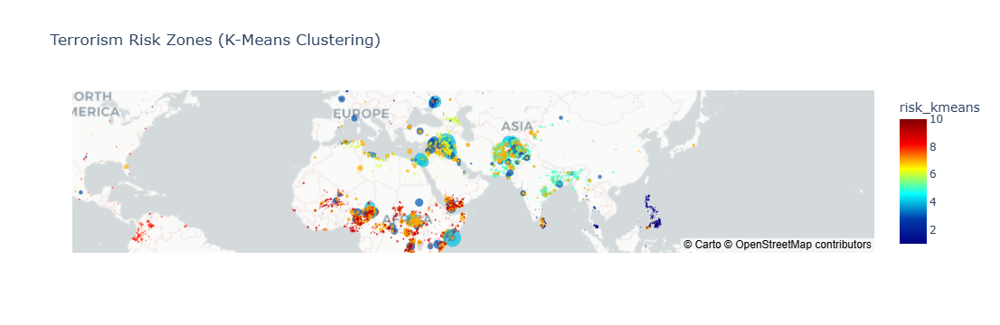

In [69]:
fig = px.scatter_mapbox(df_last10year, lat='latitude', lon='longitude',
                        color='risk_kmeans', size='nkill',
                        color_continuous_scale='Jet',
                        size_max=15, zoom=1,
                        hover_data=['country_txt','city', 'nkill','nwound', 'iyear','risk_kmeans'],
                        mapbox_style='carto-positron',
                        title='Terrorism Risk Zones (K-Means Clustering)')
fig.show()

##### DBSCAN  Model

In [75]:
best_score = -1
best_eps = None
#for eps in [0.25, 0.30, 0.35, 0.45, 0.50, 0.55, 0.60, 0.65, 0.70, 0.75, 0.80]:
for eps in [0.70, 0.75, 0.80]:
    db = DBSCAN(eps=eps, min_samples=5)
    db.fit_predict(X_scaled)
    labels = db.labels_
    mylen = len(set(labels))
    if len(set(labels)) > 1:
        score = silhouette_score(X_scaled, labels)
        if score > best_score:
            best_score = score
            best_eps = eps
        print(f"\neps: {eps}, score: {score}, len:{mylen}")

print(f"\nBest eps: {best_eps}, best silhouette: {best_score}")


eps: 0.7, score: 0.5549286854465925, len:16

eps: 0.75, score: 0.5653975127164664, len:13

eps: 0.8, score: 0.5614249376644024, len:13

Best eps: 0.75, best silhouette: 0.5653975127164664


In [77]:
dbscan = DBSCAN(eps=best_eps, min_samples=5)
clusters_dbscan = dbscan.fit_predict(X_scaled)
df_last10year['risk_dbscan'] = clusters_dbscan + 1

In [79]:
# Have to comment out the following to reduce the file size

# fig = px.scatter_mapbox(df_last10year, lat='latitude', lon='longitude',
#                         color='risk_dbscan', size='nkill',
#                         color_continuous_scale='Jet',
#                         size_max=15, zoom=1,
#                         hover_data=['country_txt','city', 'nkill','nwound', 'iyear','risk_kmeans'],
#                         mapbox_style='carto-positron',
#                         title='Terrorism Risk Zones (DBSCAN Clustering)')
# fig.show()

##### Gaussian Mixture Models (GMM)

In [82]:
best_score = -1
best_n = 2
for n in range(2, 10):
    gmm = GaussianMixture(n_components=n, random_state=42)
    gmm.fit(X_scaled)
    labels = gmm.predict(X_scaled)
    score = silhouette_score(X_scaled, labels)
    if score > best_score:
        best_score = score
        best_n = n
    print(f"n_components={n}, silhouette_score={score}")
print(f"\nBest n: {best_n}, best silhouette: {best_score}")

n_components=2, silhouette_score=0.24473246689687553
n_components=3, silhouette_score=-0.008183308922404502
n_components=4, silhouette_score=-0.017449724831773258
n_components=5, silhouette_score=-0.0316641159837332
n_components=6, silhouette_score=-0.10134698555550295
n_components=7, silhouette_score=-0.014021957232112161
n_components=8, silhouette_score=-0.09464004082638511
n_components=9, silhouette_score=-0.09176071525923986

Best n: 2, best silhouette: 0.24473246689687553


In [84]:
gmm = GaussianMixture(n_components=best_n, random_state=42)
clusters_gmm = gmm.fit_predict(X_scaled)
df_last10year['risk_gmm'] = clusters_gmm + 1

In [86]:
# Have to comment out the following to reduce the file size

# fig = px.scatter_mapbox(df_last10year, lat='latitude', lon='longitude',
#                         color='risk_gmm', size='nkill',
#                         color_continuous_scale='Jet',
#                         size_max=15, zoom=1,
#                         hover_data=['country_txt','city', 'nkill','nwound', 'iyear','risk_kmeans'],
#                         mapbox_style='carto-positron',
#                         title='Terrorism Risk Zones (Gaussian Mixture Models Clustering)')
# fig.show()

#### Model evaluation

The silhouette_score is used to evaluate the models sinc it a key evaluation metric in unsupervised learning, especially for clustering algorithms like KMeans, DBSCAN, or Gaussian Mixture Models.

In [90]:
kmeans_labels = kmeans.labels_
kmeans_silhouette = silhouette_score(X_scaled, kmeans_labels)
print("kmeans_silhouette:" + str(kmeans_silhouette))

dbscan_labels = dbscan.labels_
if len(set(dbscan_labels)) > 1:
    dbscan_silhouette = silhouette_score(X_scaled, dbscan_labels)
    print("dbscan_silhouette:" + str(dbscan_silhouette))

gmm.fit(X_scaled)
gmm_labels = gmm.predict(X_scaled)
gmm_silhouette = silhouette_score(X_scaled, gmm_labels)
print("gmm_silhouette:" + str(gmm_silhouette))

kmeans_silhouette:0.43150234703075435
dbscan_silhouette:0.5653975127164664
gmm_silhouette:0.24473246689687553


##### Choose the best model

Based on the evaluation results, DBSCAN achieved the highest silhouette score of 0.5654, indicating the best clustering quality among the models tested. KMeans followed with a silhouette score of 0.4315, which is still reasonably good. Notably, DBSCAN produced 13 clusters, which is close to the expected target of 10, suggesting that it effectively captured the underlying structure of the data. However, a key limitation of DBSCAN is that it does not support direct prediction on new or unseen data points, making it less practical for scenarios where future risk assessment is needed—such as evaluating risk for new locations. Considering both performance and usability, I selected KMeans as the final model, since it balances good clustering quality with the ability to generalize and predict cluster assignments for new data.

Below is the table used to translate the estimated scale into travel risk titles:
| Scale | Travel Risk Title     | Remarks                                                                                     |
|-------|-----------------------|---------------------------------------------------------------------------------------------|
| 1–2   | Very Low Risk         | Historically very few or no incidents with kills or wounds, even in surrounding areas.      |
| 3–4   | Low Risk              | Significantly low number of attacks with kills, or wounds.                                 |
| 5–6   | Moderate Risk         | Average number of attacks with kills, or wounds; exercise normal caution.                   |
| 7–8   | High Risk             | Above-average number of incidents; travel is strongly discouraged.                         |
| 9     | Very High Risk        | Frequent attacks with high casualties; travel is strongly discouraged.                     |
| 10    | Extreme Risk          | Extremely high number of attacks or casualties; travel is not advised under any condition. |


In [95]:
def travel_risk_from_predicted_scale(cluster_value):
    if cluster_value <= 2:
        return "Very Low Risk"
    elif cluster_value <= 4:
        return "Low Risk"
    elif cluster_value <= 6:
        return "Moderate Risk"
    elif cluster_value <= 8:
        return "High Risk"
    elif cluster_value == 9:
        return "Very High Risk"
    else:
        return "Extreme Risk"

def predict_travel_risk_by_city(city, country):
    #Step 1: Get the latitude and longitude
    nominatim = Nominatim(user_agent="HHou_kmeans_risk_prediction_for_travel_to-" + city + "_" + country + "-Capstone_Project")
    time.sleep(1)
    city_location = nominatim.geocode( city + ", " + country)
    city_lat = city_location.latitude
    city_lon = city_location.longitude

    #Step 2: Prepare the dataframe
    nkill = df_last10year['nkill'].mean()
    nwound = df_last10year['nwound'].mean()
    if city in df_last10year['city'].values:
        city_data = df_last10year[df_last10year['city'] == city]    
        nkill = city_data['nkill'].mean()
        nwound = city_data['nwound'].mean()
    elif country in df_last10year['country_txt'].values:
        country_data = df_last10year[df_last10year['country_txt'] == country]
        nkill = country_data['nkill'].mean()
        nwound = country_data['nwound'].mean()      
    nkill_weighted = nkill * 3
    city_features = pd.DataFrame([[city_lat, city_lon, nkill_weighted, nwound]],
                                   columns=['latitude', 'longitude', 'nkill_weighted', 'nwound'])
    city_scaled = scaler.transform(city_features)

    #Step 3: Predict
    city_risk_scale = kmeans.predict(city_scaled)[0] + 1
    city_risk = travel_risk_from_predicted_scale(city_risk_scale)
    return {"scale":city_risk_scale, "risk":city_risk}

#### Use case: Predict risk level of Tehran, Iran to support pre-travel guidance and decision-making 

In [98]:
result = predict_travel_risk_by_city("Tehran", "Iran")
print(f"Predicted risk level for Tehran, Iran is: {result['scale']}")
print(f"Estimated travel risk to Tehran, Iran is: {result['risk']}")

Predicted risk level for Tehran, Iran is: 6
Estimated travel risk to Tehran, Iran is: Moderate Risk
